In [10]:
# Clone the official StyleGAN repository from GitHub
!git clone https://github.com/NVlabs/stylegan.git

fatal: destination path 'stylegan' already exists and is not an empty directory.


In [11]:
%tensorflow_version 1.x
import os
import pickle
import numpy as np
import PIL.Image
import stylegan
from stylegan import config
from stylegan.dnnlib import tflib
from tensorflow.python.util import module_wrapper
module_wrapper._PER_MODULE_WARNING_LIMIT = 0

# Initialize TensorFlow
tflib.init_tf()

# Go into that cloned directory
path = 'stylegan/'
if "stylegan" not in os.getcwd():
    os.chdir(path)

# Load pre-trained network
# url = 'https://drive.google.com/uc?id=1MEGjdvVpUsu1jB4zrXZN7Y4kBBOzizDQ' # Downloads the pickled model file: karras2019stylegan-ffhq-1024x1024.pkl
url = 'https://bitbucket.org/ezelikman/gans/downloads/karras2019stylegan-ffhq-1024x1024.pkl'
with stylegan.dnnlib.util.open_url(url, cache_dir=config.cache_dir) as f:
  print(f)
  _G, _D, Gs = pickle.load(f)
#   Gs.print_layers()  # Print network details

<_io.BufferedReader name='cache/d2a38577d3c883e2bc684fb7d32c3bab_karras2019stylegan-ffhq-1024x1024.pkl'>


[None, 512]
Noise vector has size 512


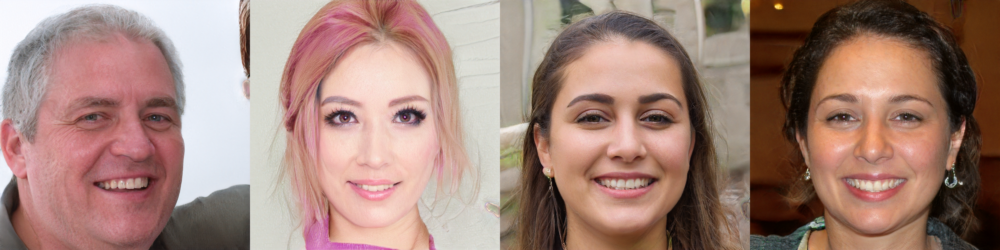

In [12]:
# Set the random seed that generates the noise vectors
rnd = np.random.RandomState(0)

# Set the number of images to generate
batch_size = 4

# Set the truncation value for truncation trick sampling
truncation = 0.7

print(Gs.input_shape)
# Create a noise vector z for each sample in the batch: (batch_size, z_dim)
z_dim = Gs.input_shape[1] # StyleGAN authors use the image dim (512) as the size of z
print(f'Noise vector has size {z_dim}')
noise_vectors = rnd.randn(batch_size, z_dim)

# Generate image by running (sampling) the generator
fmt = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True) # Specify the desired output format and shape
images = Gs.run(noise_vectors,
                None,    # No labels/conditions because it is unconditional generation (more on this in the coming lectures)
                truncation_psi=truncation, 
                randomize_noise=False,
                output_transform=fmt
                )

# Display images
if batch_size > 1:
  img = np.concatenate(images, axis=1) # Save all images in batch to a single image
else:
  img = images[0]
PIL.Image.fromarray(img, 'RGB')

[None, 512]
Noise vector has size 512
(10, 512)
(1024, 10240, 3)


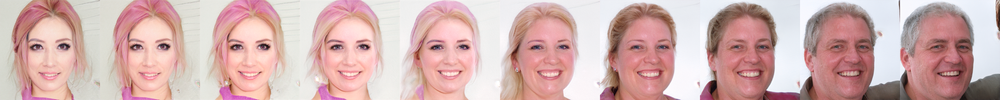

In [16]:
# Set the random seed that generates the noise vectors
rnd = np.random.RandomState(0)

# Set the number of images to generate


# Set the truncation value for truncation trick sampling
truncation = 0.7
# Set the number of interpolations/number of images to generate
n_interpolation = 10
print(Gs.input_shape)
# Create a noise vector z for each sample in the batch: (batch_size, z_dim)
z_dim = Gs.input_shape[1] # StyleGAN authors use the image dim (512) as the size of z
print(f'Noise vector has size {z_dim}')
noise_vectors_1 = rnd.randn(1, z_dim)

noise_vectors_2 = rnd.randn(1, z_dim)

perc_1_img = np.linspace(0,1,n_interpolation)[:,None]

noise_vectors = noise_vectors_1 * perc_1_img + noise_vectors_2 * (1 - perc_1_img)
print(noise_vectors.shape)
# Generate image by running (sampling) the generator
fmt = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True) # Specify the desired output format and shape
images = Gs.run(noise_vectors,
                None,    # No labels/conditions because it is unconditional generation (more on this in the coming lectures)
                truncation_psi=truncation, 
                randomize_noise=False,
                output_transform=fmt
                )

# Display images
if batch_size > 1:
  img = np.concatenate(images, axis=1) # Save all images in batch to a single image
  print(img.shape)
else:
  img = images[0]
PIL.Image.fromarray(img, 'RGB')

In [14]:
batch_size

4